# WELCOME TO THE STATE OF THE COAST APPLICATION!

## ***************** (STEP 1/3) PLEASE RUN BELOW AND SELECT POLYGON OF INTEREST *****************

In [2]:
########## RUN FIRST STEP AND SELECT POLYGON ############# YOU MAY NEED TO INSTALL pip install pymupdf
import pystac_client
import xarray as xr
import matplotlib.pyplot as plt
import pathlib
import os
import numpy as np
import geopandas as gpd
import matplotlib as mpl
from matplotlib import colors
import rasterio

import cartopy.crs as ccrs
import cartopy
import plotly.graph_objects as go
import plotly.express as px
from rasterio.plot import show
import fitz
import matplotlib.colors as mcolors
from shapely.geometry import Point
import pandas as pd

from tqdm import tqdm

import webbrowser
from pathlib import Path
import os
import time
import webbrowser


from ipyleaflet import Map, basemaps,DrawControl
import geopandas as gpd
from shapely.geometry import Polygon
import ipywidgets as widgets
from IPython.display import display

#Change to user documents folder or GCS bucket

# Define the path for the temporary folder
directory_path = os.path.expanduser("~/Documents/State of the Coast App\PDF_Plots")
os.makedirs(directory_path, exist_ok=True)
folder_path = os.path.expanduser("~/Documents/State of the Coast App\Modified_PDF")
os.makedirs(folder_path, exist_ok=True)
directory_path_PDF_Template = os.path.expanduser("~/Documents/State of the Coast App/Template_PDF/SOTC_Template_PDF_Final.pdf")
os.makedirs(os.path.dirname(directory_path_PDF_Template), exist_ok=True)


directory_path_PDF_modified=os.path.expanduser("~/Documents/State of the Coast App\Modified_PDF\SOTC_Modified_PDF.pdf")

Cloud_path_PDF_Template=r"https://storage.googleapis.com/dgds-data-public/gca/SOTC/Aux/SOTC_Template_PDF_Final2.pdf"

m = Map(basemap=basemaps.Esri.WorldImagery, scroll_wheel_zoom=True,width=800, height=1000)
m.center = ( 18.1,-73.3)
m.zoom=5.5
# Create a DrawControl widget
draw_control = DrawControl()

# Add the DrawControl widget to the map
m.add_control(draw_control)
m.layout.height="800px"
m.layout.width="2000px"
message = "                                                                                                Please zoom in and create a polygon in the area of interest"
print("                                                                                                     "+"*" * 50)
print(message.center(50))
print("                                                                                                     "+"*" * 50)

m

                                                                                                     **************************************************
                                                                                                Please zoom in and create a polygon in the area of interest
                                                                                                     **************************************************


Map(center=[18.1, -73.3], controls=(ZoomControl(options=['position', 'zoom_in_text', 'zoom_in_title', 'zoom_ou…

## **** (STEP 2/3) PLEASE RUN BELOW AND SELECT YOUR TRANSECT AND RISK TYPE OF INTEREST ****

#### IF NO POLYGON WAS CHOSEN ABOVE, THE ENTIRE CARIBBEAN REGION WILL BE SELECTED AS DEFAULT

Button(description='Submit', style=ButtonStyle())

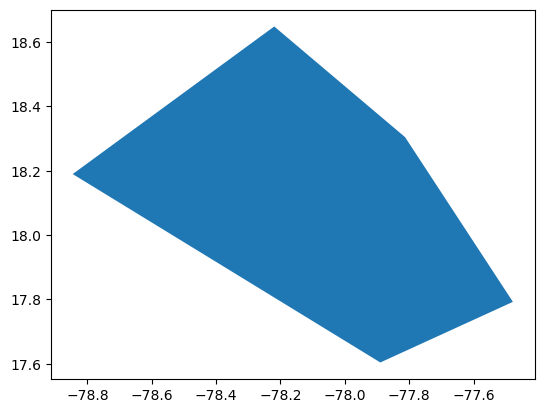

Simple 100yr RP Offshore Wave Height End-Century (2100) High_Emission (SSP5-85) BOX_138_158_23


In [3]:
#(STEP 2/3) PLEASE RUN BELOW AND SELECT YOUR TRANSECT AND RISK TYPE OF INTEREST
region_acronym= "CAR"
last_drawn_shape = draw_control.last_draw['geometry']
IPCC=gpd.read_file(r"https://storage.googleapis.com/dgds-data-public/gca/SOTC/Aux/IPCC-WGI-reference-regions-v4.gpkg")
region_gdf=IPCC.loc[IPCC["Acronym"]==region_acronym,:]

if last_drawn_shape== None:
    user_gdf=region_gdf.to_crs("EPSG:4326")
    user_gdf.index=range(0,len(user_gdf.index))
else:
    # Create a Shapely Polygon object from the coordinates
    polygon = Polygon(last_drawn_shape['coordinates'][0])
    # Create a GeoDataFrame from the polygon
    user_gdf = gpd.GeoDataFrame(geometry=[polygon])
# Print the GeoDataFrame
# user_gdf.plot()
# Now we can do a Spatial Joinbetween the STAC Zarr and or we can slice based on the extends
max_extents = user_gdf.bounds
max_extents
# Extract the min and max coordinates
min_lon_orig, min_lat_orig, max_lon_orig, max_lat_orig = max_extents['minx'][0], max_extents['miny'][0], max_extents['maxx'][0], max_extents['maxy'][0]
min_lon_orig, min_lat_orig, max_lon_orig, max_lat_orig
catalog = pystac_client.Client.open(
    "https://storage.googleapis.com/dgds-data-public/gca/SOTC/gca-stac_sotc/catalog.json" # cloud API
    #os.path.join(os.path.dirname(cwd), "stac_folder", "current", "catalog.json") # local clone 
)
# list(catalog.get_children())
collection= catalog.get_child("SOTC-Coastal_Risk_Levels_PC_FC")
collection
href=collection.assets["data"].href
#Open Dataset
ds=xr.open_zarr(href)
SOTC_df=ds.to_dataframe()
SOTC_gdf = gpd.GeoDataFrame(
    SOTC_df, geometry=gpd.points_from_xy(SOTC_df.lon, SOTC_df.lat), crs="EPSG:4326"
)
#Covert Bytes to string
for column in SOTC_gdf.columns:
    # Check if the column contains bytes
    if SOTC_gdf[column].dtype == 'object':
        if SOTC_gdf[column].apply(lambda x: isinstance(x, bytes)).any():
            # Decode bytes to string
            SOTC_gdf[column] = SOTC_gdf[column].apply(lambda x: x.decode() if isinstance(x, bytes) else x)
SOTC_gdf.head()
#Filter based on selected Bounding Box
filtered_SOTC_gdf=SOTC_gdf.sjoin(user_gdf.set_crs(SOTC_gdf.crs))
# Hover over the node of interest, and type the name of the transect_ID below
### If none is given, a Random one will be chosen
import plotly.express as px
import plotly.io as pio

dropdown_transect_ID_number=min(10000,len(filtered_SOTC_gdf["transect_id"].values))

# Function to save data
def save_data(button):
    global processing_type, hazard_type, horizon, scenario, transect1,transect2,transect_id_sel
    
    transect1 = text.value
    transect2 = dropdown_transect_ID.value
    
    if len(transect1)>len(transect2):
        transect_id_sel = text.value
    else:
        transect_id_sel = dropdown_transect_ID.value
        
    processing_type = dropdown_process.value
    hazard_type = dropdown_haz.value
    horizon = dropdown_horizon.value
    scenario = dropdown_scenario.value
    print(processing_type, hazard_type, horizon, scenario, transect_id_sel)

# Function to update Horizon Period options based on Hazard Type selection
def update_horizon_options(change):
    global change_out
    if change['new'] == '100yr RP Offshore Wave Height':
        dropdown_horizon.options = ['Present', 'End-Century (2100)']
        dropdown_scenario.options = [""]
    elif change['new'] == 'Land Subsidence':
        dropdown_horizon.options = ['Present', 'Mid-Century (2050)']
        dropdown_scenario.options = ["",'High_Emission (SSP5-85)']
    elif change['new'] == '100yr RP Extreme Sea Level' or change['new'] == 'Shoreline Erosion':
        dropdown_horizon.options = horizon_options_all
        dropdown_scenario.options = scenario_options
    change_out=change['new']

# Function to update Horizon Period options based on Hazard Type selection
def update_scenario_options(change2):
    global change2_out
    if change2['new'] == 'Present':
        dropdown_scenario.options = [""]
    if change2['new'] == 'Mid-Century (2050)' and change_out== 'Land Subsidence':
        dropdown_scenario.options = ['High_Emission (SSP5-85)']
    else:
        dropdown_scenario.options = scenario_options
    change2_out=change2['new']

# Available options for the dropdown
transect_ID_options=filtered_SOTC_gdf["transect_id"].head(dropdown_transect_ID_number).values
processing_options = ['Simple', 'Advanced']
Hazard_options = [ '100yr RP Extreme Sea Level', '100yr RP Offshore Wave Height','Land Subsidence', 'Shoreline Erosion']
horizon_options_all = ['End-Century (2100)', 'Mid-Century (2050)', 'Present']
scenario_options = ['High_Emission (SSP5-85)', 'Low_Emission (SSP1-26)',""]

# Text widget for instructions
text = widgets.Text(placeholder='Enter the transect ID of interest')

# Dropdown widgets for multiple-choice options
dropdown_transect_ID = widgets.Dropdown(options=transect_ID_options)
dropdown_process = widgets.Dropdown(options=processing_options)
dropdown_haz = widgets.Dropdown(options=Hazard_options)
dropdown_horizon = widgets.Dropdown(options=horizon_options_all)
dropdown_scenario = widgets.Dropdown(options=scenario_options)

# Descriptions for dropdowns
desc_transect_ID = widgets.Label(value=f"Or Quickly Select from first {dropdown_transect_ID_number} Transect IDs:")
desc_process = widgets.Label(value='Processing Type:')
desc_haz = widgets.Label(value='Hazard Type:')
desc_horizon = widgets.Label(value='Horizon Period:')
desc_scenario = widgets.Label(value='Emission Type:')

# Button to submit
button = widgets.Button(description='Submit')
button.on_click(save_data)



# Observe changes in Hazard Type dropdown
dropdown_haz.observe(update_horizon_options, names='value')

# Observe changes in Horizon Type dropdown
dropdown_horizon.observe(update_scenario_options, names='value')


# Layout widgets horizontally
input_widgets_left = widgets.VBox([desc_process, desc_haz, desc_horizon, desc_scenario])
input_widgets_right = widgets.VBox([dropdown_process, dropdown_haz, dropdown_horizon, dropdown_scenario])
Hazard_widgets = widgets.HBox([input_widgets_left, input_widgets_right])


Transect_ID_widgets = widgets.HBox([text, desc_transect_ID, dropdown_transect_ID])

# Display widgets
display(Transect_ID_widgets)
display(Hazard_widgets)
display(button)






###################################
##PLOT 
###################################




long_name = "EWH_100yrRP_PC___Hazard_Level"
# Define tick names
tick_names = ["Very Low", "Low", "Moderate", "High", "Very High"]

tk1=np.min(filtered_SOTC_gdf[long_name].dropna())
tk5=np.max(filtered_SOTC_gdf[long_name].dropna())
tk3=np.mean([tk1,tk5])
tk4=np.mean([tk3,tk5])
tk2=np.mean([tk3,tk1])


tick_vals= [tk1, tk2,tk3, tk4, tk5]


# Define parameters

color_scale = ['#33f510', '#3CB371', '#FFFF00', '#FFA500', '#FF4500']

# Update Hazard Component values


# Sort values for Risk level view
sorted_CCN = filtered_SOTC_gdf.sort_values(long_name)

# Create scatter map plot
fig = px.scatter_mapbox(sorted_CCN,
                                lat=sorted_CCN["geometry"].y,
                                lon=sorted_CCN["geometry"].x,
                                hover_name=long_name,
                                hover_data=["transect_id", "country"],
                                color=sorted_CCN[long_name],
                                color_continuous_scale=color_scale,
                                mapbox_style="carto-positron",
                                width=2000,
                                height=1200)
# Update the tick labels
fig.update_layout(coloraxis_colorbar=dict(title=long_name, tickvals=tick_vals, ticktext=tick_names, tickfont=dict(size=15, color='black')))

# Extract the min and max coordinates
max_extents = sorted_CCN.total_bounds
min_lon, min_lat, max_lon, max_lat = max_extents

# Calculate the polygon center
center_lat = (max_lat + min_lat) / 2
center_lon = (max_lon + min_lon) / 2

max_extent_height = max_lat - min_lat
max_extent_width = max_lon - min_lon

max_bound = max(abs(max_extent_height), abs(max_extent_width)) * 111
zoom = 11.5 - np.log(max_bound)
zoom_level = 13.5 - np.log(max_bound)

# Update the layout with the calculated center and zoom level
fig.update_layout(mapbox=dict(center=dict(lat=center_lat, lon=center_lon), zoom=zoom_level), title=f"<b>Remember to Click Submit!</b>",title_font=dict(size=30),title_x=0.5)
fig.update_layout(
    mapbox_style="carto-positron",
    mapbox_layers=[
        # {
        #     "below": 'traces',
        #     "sourcetype": "raster",
        #     "sourceattribution": "ESRI World Imagery",
        #     "source": [
        #         "https://services.arcgisonline.com/arcgis/rest/services/World_Imagery/MapServer/tile/{z}/{y}/{x}"
        #     ]
        # },
        {
            "below": 'traces',
            "sourcetype": "raster",
            "sourceattribution": "Google Maps",
            "source": [
                "http://mt0.google.com/vt/lyrs=s&hl=en&x={x}&y={y}&z={z}"
            ]
        },
        # {
        #     "below": 'traces',
        #     "sourcetype": "raster",
        #     "sourceattribution": "United States Geological Survey",
        #     "source": [
        #         "https://basemap.nationalmap.gov/arcgis/rest/services/USGSImageryOnly/MapServer/tile/{z}/{y}/{x}"
        #     ]
        # },
        # {
        #     "below": 'traces',
        #     "sourcetype": "raster",
        #     "sourceattribution": "Bing Maps Satellite Imagery",
        #     "source": [
        #         "https://t0.tiles.virtualearth.net/tiles/a{q}.jpeg?g=685&mkt=en-us&n=z"
        #     ]
        # },
      

      ]
      )

fig.show()

fig_name_shoreline="Main Plot"+long_name+' shoreline_plot-RAW.png'
pio.write_image(fig, os.path.join(directory_path, fig_name_shoreline))


## ********************* (STEP 3/3) PLEASE RUN THE FINAL STEP AND PATIENTLY WAIT ON YOUR PDF ******************

Index(['EWH_100yrRP_2100_RCP_45___Hazard_Level',
       'EWH_100yrRP_2100_RCP_45___Risk_Level',
       'EWH_100yrRP_2100_RCP_45___Risk_Level_Class',
       'EWH_100yrRP_2100_RCP_45_value',
       'EWH_100yrRP_2100_RCP_85___Hazard_Level',
       'EWH_100yrRP_2100_RCP_85___Risk_Level',
       'EWH_100yrRP_2100_RCP_85___Risk_Level_Class',
       'EWH_100yrRP_2100_RCP_85_value', 'EWH_100yrRP_PC___Hazard_Level',
       'EWH_100yrRP_PC___Risk_Level', 'EWH_100yrRP_PC___Risk_Level_Class',
       'EWH_100yrRP_PC_value'],
      dtype='object')
Index(['EWH_100yrRP_2100_RCP_45___Hazard_Level',
       'EWH_100yrRP_2100_RCP_45___Risk_Level',
       'EWH_100yrRP_2100_RCP_45___Risk_Level_Class',
       'EWH_100yrRP_2100_RCP_45_value',
       'EWH_100yrRP_2100_RCP_85___Hazard_Level',
       'EWH_100yrRP_2100_RCP_85___Risk_Level',
       'EWH_100yrRP_2100_RCP_85___Risk_Level_Class',
       'EWH_100yrRP_2100_RCP_85_value'],
      dtype='object')
Index(['EWH_100yrRP_2100_RCP_85___Hazard_Level',
       'EW

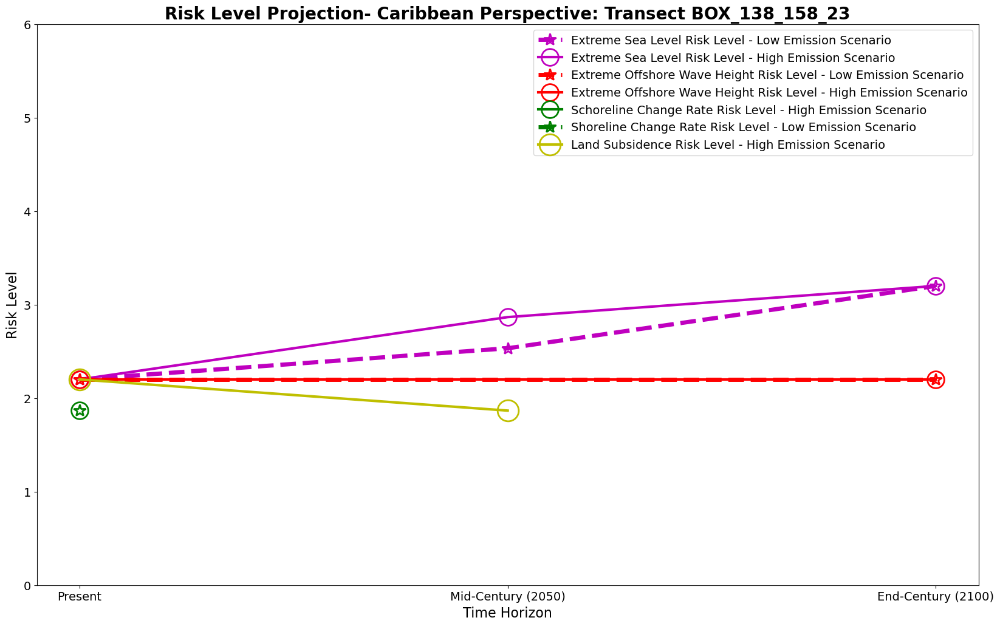

Directory 'C:\Users\rowe/Documents/State of the Coast App/Template_PDF' and all its contents have been deleted successfully.


In [5]:
#(STEP 3/3) PLEASE RUN REMAINING AND WAIT ON YOUR PDF
## Filters the exact Selected Coastal Risk Type, Time Horizon and Scenario based on common words, or numbers
short_haz=["ESL","EWH","Land","Change_"]
short_horiz1=["2100","2050","PC"]
short_horiz2=["2100","2040","PC"] #Leeway for land_sub
short_scen1=["8","4",""] #Leeway for rcp 4.5
short_scen2=["8","6",""]  #Leeway for ssp2.6
short_scen3=["high","2010",""]  #Leeway for land_sub

for i in range(0,len(Hazard_options)):
    if hazard_type==Hazard_options[i]:
        var=short_haz[i]
for i in range(0,len(horizon_options_all)):
    if horizon==horizon_options_all[i]:
        hor1=short_horiz1[i]
        hor2=short_horiz2[i]
for i in range(0,len(scenario_options)):
    if scenario==scenario_options[i]:
        scen1=short_scen1[i]
        scen2=short_scen1[i]
        scen3=short_scen3[i]




var,hor1,hor2,scen1,scen2,scen3
gdf=filtered_SOTC_gdf.copy()
### FILTER FOR VARIABLE
Variable_sel=[]
for cols in gdf.columns:
    Variable_sel.append(var in cols)
Haz=gdf.columns[Variable_sel]
print(Haz)

### FILTER FOR HORIZON
Variable_sel=[]
for cols in Haz:
    Variable_sel.append(hor1 in cols or hor2 in cols )
Haz_hor=Haz[Variable_sel]
print(Haz_hor)

### FILTER FOR EMISSION SCENARIO
Variable_sel=[]
for cols in Haz_hor:
    Variable_sel.append(scen1 in cols or scen2 in cols or scen3 in cols)
Haz_hor_scen=Haz_hor[Variable_sel]
print(Haz_hor_scen)

### FILTER FOR RISK LEVEL
Variable_sel=[]
for cols in Haz_hor_scen:
    Variable_sel.append("Risk_Level" in cols and "Class" not in cols)
Haz_hor_scen_risk=Haz_hor_scen[Variable_sel].values[0]
print(Haz_hor_scen_risk)
###################################
##PLOT National Page 5 Country Perpective from Country view
###################################



long_name = Haz_hor_scen_risk
nonan=SOTC_gdf[~SOTC_gdf[long_name].isna()].copy()

    

###############
# Select Perspective
###############
view_name=SOTC_gdf["IPCC_REGION"].mode().values[0]
perspective_name=SOTC_gdf["IPCC_REGION"].mode().values[0]

if "Land" in long_name or "Change_rate_SSP" in long_name:
    view=nonan[nonan["IPCC_REGION"]==view_name]   
    perspective=nonan[nonan["IPCC_REGION"]==perspective_name] 
else:
    view=SOTC_gdf[SOTC_gdf["IPCC_REGION"]==view_name]   
    perspective=SOTC_gdf[SOTC_gdf["IPCC_REGION"]==perspective_name]





# Define tick names
tick_names = ["Very Low", "Low", "Moderate", "High", "Very High"]
tk1=np.min(perspective[long_name].dropna())
tk5=np.max(perspective[long_name].dropna())
tk3=np.mean([tk1,tk5])
tk4=np.mean([tk3,tk5])
tk2=np.mean([tk3,tk1])


tick_vals= [tk1, tk2,tk3, tk4, tk5]


# Define parameters

color_scale = ['#33f510', '#3CB371', '#FFFF00', '#FFA500', '#FF4500']

# Update Hazard Component values


# Sort values for Risk level view
sorted_CCN = view.sort_values(long_name)

# Create scatter map plot
fig = px.scatter_mapbox(sorted_CCN,
                                lat=sorted_CCN["geometry"].y,
                                lon=sorted_CCN["geometry"].x,
                                hover_name=long_name,
                                hover_data=["transect_id", "country"],
                                color=sorted_CCN[long_name],
                                color_continuous_scale=color_scale,
                                mapbox_style="carto-positron",
                                width=2000,
                                height=1200)
# Update the tick labels
fig.update_layout(coloraxis_colorbar=dict(title=long_name, tickvals=tick_vals, ticktext=tick_names, tickfont=dict(size=15, color='black')))

# Extract the min and max coordinates
max_extents = region_gdf.total_bounds
min_lon, min_lat, max_lon, max_lat = max_extents

# Calculate the polygon center
center_lat = (max_lat + min_lat) / 2
center_lon = (max_lon + min_lon) / 2

max_extent_height = max_lat - min_lat
max_extent_width = max_lon - min_lon

max_bound = max(abs(max_extent_height), abs(max_extent_width)) * 111
zoom = 11.5 - np.log(max_bound)
zoom_level = 13.5 - np.log(max_bound)

# Update the layout with the calculated center and zoom level
fig.update_layout(mapbox=dict(center=dict(lat=center_lat, lon=center_lon), zoom=zoom_level), title=f"<b>Risk Level Distribution along {view_name}'s shoreline- From {perspective_name}'s Perspective</b>",title_font=dict(size=30),title_x=0.5)
fig.update_layout(
    mapbox_style="carto-positron",
    mapbox_layers=[
        # {
        #     "below": 'traces',
        #     "sourcetype": "raster",
        #     "sourceattribution": "ESRI World Imagery",
        #     "source": [
        #         "https://services.arcgisonline.com/arcgis/rest/services/World_Imagery/MapServer/tile/{z}/{y}/{x}"
        #     ]
        # },
        {
            "below": 'traces',
            "sourcetype": "raster",
            "sourceattribution": "Google Maps",
            "source": [
                "http://mt0.google.com/vt/lyrs=s&hl=en&x={x}&y={y}&z={z}"
            ]
        },
        {
            "below": 'traces',
            "sourcetype": "raster",
            "sourceattribution": "United States Geological Survey",
            "source": [
                "https://basemap.nationalmap.gov/arcgis/rest/services/USGSImageryOnly/MapServer/tile/{z}/{y}/{x}"
            ]
        },
        # {
        #     "below": 'traces',
        #     "sourcetype": "raster",
        #     "sourceattribution": "Bing Maps Satellite Imagery",
        #     "source": [
        #         "https://t0.tiles.virtualearth.net/tiles/a{q}.jpeg?g=685&mkt=en-us&n=z"
        #     ]
        # },
      

      ]
      )

fig.show()

fig_name_shoreline="Region Plot from Region Perspective shoreline_plot-RAW.png"
pio.write_image(fig, os.path.join(directory_path, fig_name_shoreline))
###################################
##PLOT National Page 5 Country Perpective from Country view
###################################



long_name = Haz_hor_scen_risk
nonan=SOTC_gdf[~SOTC_gdf[long_name].isna()].copy()

    

###############
# Select Perspective
###############
view_name=filtered_SOTC_gdf["country"].mode().values[0]
perspective_name=filtered_SOTC_gdf["country"].mode().values[0]

if "Land" in long_name or "Change_rate_SSP" in long_name:
    view=nonan[nonan["country"]==view_name]   
    perspective=nonan[nonan["country"]==perspective_name] 
else:
    view=SOTC_gdf[SOTC_gdf["country"]==view_name]   
    perspective=SOTC_gdf[SOTC_gdf["country"]==perspective_name]



# Define tick names
tick_names = ["Very Low", "Low", "Moderate", "High", "Very High"]
tk1=np.min(perspective[long_name].dropna())
tk5=np.max(perspective[long_name].dropna())
tk3=np.mean([tk1,tk5])
tk4=np.mean([tk3,tk5])
tk2=np.mean([tk3,tk1])


tick_vals= [tk1, tk2,tk3, tk4, tk5]


# Define parameters

color_scale = ['#33f510', '#3CB371', '#FFFF00', '#FFA500', '#FF4500']

# Update Hazard Component values


# Sort values for Risk level view
sorted_CCN = perspective.sort_values(long_name)

# Create scatter map plot
fig = px.scatter_mapbox(sorted_CCN,
                                lat=sorted_CCN["geometry"].y,
                                lon=sorted_CCN["geometry"].x,
                                hover_name=long_name,
                                hover_data=["transect_id", "country"],
                                color=sorted_CCN[long_name],
                                color_continuous_scale=color_scale,
                                mapbox_style="carto-positron",
                                width=2000,
                                height=1200)
# Update the tick labels
fig.update_layout(coloraxis_colorbar=dict(title=long_name, tickvals=tick_vals, ticktext=tick_names, tickfont=dict(size=15, color='black')))

# Extract the min and max coordinates
max_extents = view.total_bounds
min_lon, min_lat, max_lon, max_lat = max_extents

# Calculate the polygon center
center_lat = (max_lat + min_lat) / 2
center_lon = (max_lon + min_lon) / 2

max_extent_height = max_lat - min_lat
max_extent_width = max_lon - min_lon

max_bound = max(abs(max_extent_height), abs(max_extent_width)) * 111
zoom = 11.5 - np.log(max_bound)
zoom_level = 13.5 - np.log(max_bound)

# Update the layout with the calculated center and zoom level
fig.update_layout(mapbox=dict(center=dict(lat=center_lat, lon=center_lon), zoom=zoom_level), title=f"<b>Risk Distribution along {view_name}'s shoreline- From {perspective_name}'s Perspective</b>",title_font=dict(size=30),title_x=0.5)
fig.update_layout(
    mapbox_style="carto-positron",
    mapbox_layers=[
        # {
        #     "below": 'traces',
        #     "sourcetype": "raster",
        #     "sourceattribution": "ESRI World Imagery",
        #     "source": [
        #         "https://services.arcgisonline.com/arcgis/rest/services/World_Imagery/MapServer/tile/{z}/{y}/{x}"
        #     ]
        # },
        {
            "below": 'traces',
            "sourcetype": "raster",
            "sourceattribution": "Google Maps",
            "source": [
                "http://mt0.google.com/vt/lyrs=s&hl=en&x={x}&y={y}&z={z}"
            ]
        },
        {
            "below": 'traces',
            "sourcetype": "raster",
            "sourceattribution": "United States Geological Survey",
            "source": [
                "https://basemap.nationalmap.gov/arcgis/rest/services/USGSImageryOnly/MapServer/tile/{z}/{y}/{x}"
            ]
        },
        # {
        #     "below": 'traces',
        #     "sourcetype": "raster",
        #     "sourceattribution": "Bing Maps Satellite Imagery",
        #     "source": [
        #         "https://t0.tiles.virtualearth.net/tiles/a{q}.jpeg?g=685&mkt=en-us&n=z"
        #     ]
        # },
      

      ]
      )

fig.show()

fig_name_shoreline="Country Plot from Country Perspective shoreline_plot-RAW.png"
pio.write_image(fig, os.path.join(directory_path, fig_name_shoreline))
###################################
##PLOT National Page 5 Caribbean Perpective from Country view
###################################



long_name = Haz_hor_scen_risk
nonan=SOTC_gdf[~SOTC_gdf[long_name].isna()].copy()

    

###############
# Select Perspective
###############
view_name=filtered_SOTC_gdf["country"].mode().values[0]
perspective_name=filtered_SOTC_gdf["IPCC_REGION"].mode().values[0]


if "Land" in long_name or "Change_rate_SSP" in long_name:
    view=nonan[nonan["country"]==view_name]   
    perspective=nonan[nonan["IPCC_REGION"]==perspective_name] 
else:
    view=SOTC_gdf[SOTC_gdf["country"]==view_name]   
    perspective=SOTC_gdf[SOTC_gdf["IPCC_REGION"]==perspective_name] 



# Define tick names
tick_names = ["Very Low", "Low", "Moderate", "High", "Very High"]
tk1=np.min(perspective[long_name].dropna())
tk5=np.max(perspective[long_name].dropna())
tk3=np.mean([tk1,tk5])
tk4=np.mean([tk3,tk5])
tk2=np.mean([tk3,tk1])


tick_vals= [tk1, tk2,tk3, tk4, tk5]


# Define parameters

color_scale = ['#33f510', '#3CB371', '#FFFF00', '#FFA500', '#FF4500']

# Update Hazard Component values


# Sort values for Risk level view
sorted_CCN = perspective.sort_values(long_name)

# Create scatter map plot
fig = px.scatter_mapbox(sorted_CCN,
                                lat=sorted_CCN["geometry"].y,
                                lon=sorted_CCN["geometry"].x,
                                hover_name=long_name,
                                hover_data=["transect_id", "country"],
                                color=sorted_CCN[long_name],
                                color_continuous_scale=color_scale,
                                mapbox_style="carto-positron",
                                width=2000,
                                height=1200)
# Update the tick labels
fig.update_layout(coloraxis_colorbar=dict(title=long_name, tickvals=tick_vals, ticktext=tick_names, tickfont=dict(size=15, color='black')))

# Extract the min and max coordinates
max_extents = view.total_bounds
min_lon, min_lat, max_lon, max_lat = max_extents

# Calculate the polygon center
center_lat = (max_lat + min_lat) / 2
center_lon = (max_lon + min_lon) / 2

max_extent_height = max_lat - min_lat
max_extent_width = max_lon - min_lon

max_bound = max(abs(max_extent_height), abs(max_extent_width)) * 111
zoom = 11.5 - np.log(max_bound)
zoom_level = 13.5 - np.log(max_bound)

# Update the layout with the calculated center and zoom level
fig.update_layout(mapbox=dict(center=dict(lat=center_lat, lon=center_lon), zoom=zoom_level), title=f"<b>Risk Distribution along {view_name}'s shoreline- From {perspective_name}'s Perspective</b>",title_font=dict(size=30),title_x=0.5)
fig.update_layout(
    mapbox_style="carto-positron",
    mapbox_layers=[
        # {
        #     "below": 'traces',
        #     "sourcetype": "raster",
        #     "sourceattribution": "ESRI World Imagery",
        #     "source": [
        #         "https://services.arcgisonline.com/arcgis/rest/services/World_Imagery/MapServer/tile/{z}/{y}/{x}"
        #     ]
        # },
        {
            "below": 'traces',
            "sourcetype": "raster",
            "sourceattribution": "Google Maps",
            "source": [
                "http://mt0.google.com/vt/lyrs=s&hl=en&x={x}&y={y}&z={z}"
            ]
        },
        {
            "below": 'traces',
            "sourcetype": "raster",
            "sourceattribution": "United States Geological Survey",
            "source": [
                "https://basemap.nationalmap.gov/arcgis/rest/services/USGSImageryOnly/MapServer/tile/{z}/{y}/{x}"
            ]
        },
        # {
        #     "below": 'traces',
        #     "sourcetype": "raster",
        #     "sourceattribution": "Bing Maps Satellite Imagery",
        #     "source": [
        #         "https://t0.tiles.virtualearth.net/tiles/a{q}.jpeg?g=685&mkt=en-us&n=z"
        #     ]
        # },
      

      ]
      )

fig.show()

fig_name_shoreline="Country Plot from Region Perspective shoreline_plot-RAW.png"
pio.write_image(fig, os.path.join(directory_path, fig_name_shoreline))
###################################
##PLOT National Page 5 County Perpective from BBOX view
###################################



long_name = Haz_hor_scen_risk
nonan_filt=filtered_SOTC_gdf[~filtered_SOTC_gdf[long_name].isna()].copy()
nonan=SOTC_gdf[~SOTC_gdf[long_name].isna()].copy()

    

###############
# Select Perspective
###############
view_name="Bounding Box"
perspective_name=filtered_SOTC_gdf["IPCC_REGION"].mode().values[0]


if "Land" in long_name or "Change_rate_SSP" in long_name:
    view=nonan_filt
    perspective=nonan[nonan["IPCC_REGION"]==perspective_name] 
else:
    view=filtered_SOTC_gdf 
    perspective=SOTC_gdf[SOTC_gdf["IPCC_REGION"]==perspective_name] 



# Define tick names
tick_names = ["Very Low", "Low", "Moderate", "High", "Very High"]
tk1=np.min(perspective[long_name].dropna())
tk5=np.max(perspective[long_name].dropna())
tk3=np.mean([tk1,tk5])
tk4=np.mean([tk3,tk5])
tk2=np.mean([tk3,tk1])


tick_vals= [tk1, tk2,tk3, tk4, tk5]


# Define parameters

color_scale = ['#33f510', '#3CB371', '#FFFF00', '#FFA500', '#FF4500']

# Update Hazard Component values


# Sort values for Risk level view
sorted_CCN = perspective.sort_values(long_name)

# Create scatter map plot
fig = px.scatter_mapbox(sorted_CCN,
                                lat=sorted_CCN["geometry"].y,
                                lon=sorted_CCN["geometry"].x,
                                hover_name=long_name,
                                hover_data=["transect_id", "country"],
                                color=sorted_CCN[long_name],
                                color_continuous_scale=color_scale,
                                mapbox_style="carto-positron",
                                width=2000,
                                height=1200)
# Update the tick labels
fig.update_layout(coloraxis_colorbar=dict(title=long_name, tickvals=tick_vals, ticktext=tick_names, tickfont=dict(size=15, color='black')))

# Extract the min and max coordinates
max_extents = view.total_bounds
min_lon, min_lat, max_lon, max_lat = max_extents

# Calculate the polygon center
center_lat = (max_lat + min_lat) / 2
center_lon = (max_lon + min_lon) / 2

max_extent_height = max_lat - min_lat
max_extent_width = max_lon - min_lon

max_bound = max(abs(max_extent_height), abs(max_extent_width)) * 111
zoom = 11.5 - np.log(max_bound)
zoom_level = 13.5 - np.log(max_bound)

# Update the layout with the calculated center and zoom level
fig.update_layout(mapbox=dict(center=dict(lat=center_lat, lon=center_lon), zoom=zoom_level), title=f"<b>Risk Distribution along {view_name}'s shoreline- From {perspective_name}'s Perspective</b>",title_font=dict(size=30),title_x=0.5)
fig.update_layout(
    mapbox_style="carto-positron",
    mapbox_layers=[
        # {
        #     "below": 'traces',
        #     "sourcetype": "raster",
        #     "sourceattribution": "ESRI World Imagery",
        #     "source": [
        #         "https://services.arcgisonline.com/arcgis/rest/services/World_Imagery/MapServer/tile/{z}/{y}/{x}"
        #     ]
        # },
        {
            "below": 'traces',
            "sourcetype": "raster",
            "sourceattribution": "Google Maps",
            "source": [
                "http://mt0.google.com/vt/lyrs=s&hl=en&x={x}&y={y}&z={z}"
            ]
        },
        {
            "below": 'traces',
            "sourcetype": "raster",
            "sourceattribution": "United States Geological Survey",
            "source": [
                "https://basemap.nationalmap.gov/arcgis/rest/services/USGSImageryOnly/MapServer/tile/{z}/{y}/{x}"
            ]
        },
        # {
        #     "below": 'traces',
        #     "sourcetype": "raster",
        #     "sourceattribution": "Bing Maps Satellite Imagery",
        #     "source": [
        #         "https://t0.tiles.virtualearth.net/tiles/a{q}.jpeg?g=685&mkt=en-us&n=z"
        #     ]
        # },
      

      ]
      )

fig.show()

fig_name_shoreline="BBOX Plot from Region Perspective shoreline_plot-RAW.png"
pio.write_image(fig, os.path.join(directory_path, fig_name_shoreline))
###################################
##PLOT National Page 5 Caribbean Perpective from BBOX view
###################################



long_name = Haz_hor_scen_risk
nonan_filt=filtered_SOTC_gdf[~filtered_SOTC_gdf[long_name].isna()].copy()
nonan=SOTC_gdf[~SOTC_gdf[long_name].isna()].copy()

    

###############
# Select Perspective
###############
view_name="Bounding Box"
perspective_name=filtered_SOTC_gdf["country"].mode().values[0]


if "Land" in long_name or "Change_rate_SSP" in long_name:
    view=nonan_filt
    perspective=nonan[nonan["country"]==perspective_name] 
else:
    view=filtered_SOTC_gdf 
    perspective=SOTC_gdf[SOTC_gdf["country"]==perspective_name] 



# Define tick names
tick_names = ["Very Low", "Low", "Moderate", "High", "Very High"]
tk1=np.min(perspective[long_name].dropna())
tk5=np.max(perspective[long_name].dropna())
tk3=np.mean([tk1,tk5])
tk4=np.mean([tk3,tk5])
tk2=np.mean([tk3,tk1])


tick_vals= [tk1, tk2,tk3, tk4, tk5]


# Define parameters

color_scale = ['#33f510', '#3CB371', '#FFFF00', '#FFA500', '#FF4500']

# Update Hazard Component values


# Sort values for Risk level view
sorted_CCN = perspective.sort_values(long_name)

# Create scatter map plot
fig = px.scatter_mapbox(sorted_CCN,
                                lat=sorted_CCN["geometry"].y,
                                lon=sorted_CCN["geometry"].x,
                                hover_name=long_name,
                                hover_data=["transect_id", "country"],
                                color=sorted_CCN[long_name],
                                color_continuous_scale=color_scale,
                                mapbox_style="carto-positron",
                                width=2000,
                                height=1200)
# Update the tick labels
fig.update_layout(coloraxis_colorbar=dict(title=long_name, tickvals=tick_vals, ticktext=tick_names, tickfont=dict(size=15, color='black')))

# Extract the min and max coordinates
max_extents = view.total_bounds
min_lon, min_lat, max_lon, max_lat = max_extents

# Calculate the polygon center
center_lat = (max_lat + min_lat) / 2
center_lon = (max_lon + min_lon) / 2

max_extent_height = max_lat - min_lat
max_extent_width = max_lon - min_lon

max_bound = max(abs(max_extent_height), abs(max_extent_width)) * 111
zoom = 11.5 - np.log(max_bound)
zoom_level = 13.5 - np.log(max_bound)

# Update the layout with the calculated center and zoom level
fig.update_layout(mapbox=dict(center=dict(lat=center_lat, lon=center_lon), zoom=zoom_level), title=f"<b>Risk Distribution along {view_name}'s shoreline- From {perspective_name}'s Perspective</b>",title_font=dict(size=30),title_x=0.5)
fig.update_layout(
    mapbox_style="carto-positron",
    mapbox_layers=[
        # {
        #     "below": 'traces',
        #     "sourcetype": "raster",
        #     "sourceattribution": "ESRI World Imagery",
        #     "source": [
        #         "https://services.arcgisonline.com/arcgis/rest/services/World_Imagery/MapServer/tile/{z}/{y}/{x}"
        #     ]
        # },
        {
            "below": 'traces',
            "sourcetype": "raster",
            "sourceattribution": "Google Maps",
            "source": [
                "http://mt0.google.com/vt/lyrs=s&hl=en&x={x}&y={y}&z={z}"
            ]
        },
        {
            "below": 'traces',
            "sourcetype": "raster",
            "sourceattribution": "United States Geological Survey",
            "source": [
                "https://basemap.nationalmap.gov/arcgis/rest/services/USGSImageryOnly/MapServer/tile/{z}/{y}/{x}"
            ]
        },
        # {
        #     "below": 'traces',
        #     "sourcetype": "raster",
        #     "sourceattribution": "Bing Maps Satellite Imagery",
        #     "source": [
        #         "https://t0.tiles.virtualearth.net/tiles/a{q}.jpeg?g=685&mkt=en-us&n=z"
        #     ]
        # },
      

      ]
      )

fig.show()

fig_name_shoreline="BBOX Plot from country Perspective shoreline_plot-RAW.png"
pio.write_image(fig, os.path.join(directory_path, fig_name_shoreline))
###################################
##PLOT National Page 5 BBOX Perpective from BBOX view
###################################



long_name = Haz_hor_scen_risk
nonan_filt=filtered_SOTC_gdf[~filtered_SOTC_gdf[long_name].isna()].copy()
nonan=SOTC_gdf[~SOTC_gdf[long_name].isna()].copy()

    

###############
# Select Perspective
###############
view_name="Bounding Box"
perspective_name="Bounding Box"


if "Land" in long_name or "Change_rate_SSP" in long_name:
    view=nonan_filt
    perspective=nonan_filt
else:
    view=filtered_SOTC_gdf 
    perspective=filtered_SOTC_gdf 



# Define tick names
tick_names = ["Very Low", "Low", "Moderate", "High", "Very High"]
tk1=np.min(perspective[long_name].dropna())
tk5=np.max(perspective[long_name].dropna())
tk3=np.mean([tk1,tk5])
tk4=np.mean([tk3,tk5])
tk2=np.mean([tk3,tk1])


tick_vals= [tk1, tk2,tk3, tk4, tk5]


# Define parameters

color_scale = ['#33f510', '#3CB371', '#FFFF00', '#FFA500', '#FF4500']

# Update Hazard Component values


# Sort values for Risk level view
sorted_CCN = perspective.sort_values(long_name)

# Create scatter map plot
fig = px.scatter_mapbox(sorted_CCN,
                                lat=sorted_CCN["geometry"].y,
                                lon=sorted_CCN["geometry"].x,
                                hover_name=long_name,
                                hover_data=["transect_id", "country"],
                                color=sorted_CCN[long_name],
                                color_continuous_scale=color_scale,
                                mapbox_style="carto-positron",
                                width=2000,
                                height=1200)
# Update the tick labels
fig.update_layout(coloraxis_colorbar=dict(title=long_name, tickvals=tick_vals, ticktext=tick_names, tickfont=dict(size=15, color='black')))

# Extract the min and max coordinates
max_extents = view.total_bounds
min_lon, min_lat, max_lon, max_lat = max_extents

# Calculate the polygon center
center_lat = (max_lat + min_lat) / 2
center_lon = (max_lon + min_lon) / 2

max_extent_height = max_lat - min_lat
max_extent_width = max_lon - min_lon

max_bound = max(abs(max_extent_height), abs(max_extent_width)) * 111
zoom = 11.5 - np.log(max_bound)
zoom_level = 13.5 - np.log(max_bound)

# Update the layout with the calculated center and zoom level
fig.update_layout(mapbox=dict(center=dict(lat=center_lat, lon=center_lon), zoom=zoom_level), title=f"<b>Risk Distribution along {view_name}'s shoreline- From {perspective_name}'s Perspective</b>",title_font=dict(size=30),title_x=0.5)
fig.update_layout(
    mapbox_style="carto-positron",
    mapbox_layers=[
        # {
        #     "below": 'traces',
        #     "sourcetype": "raster",
        #     "sourceattribution": "ESRI World Imagery",
        #     "source": [
        #         "https://services.arcgisonline.com/arcgis/rest/services/World_Imagery/MapServer/tile/{z}/{y}/{x}"
        #     ]
        # },
        {
            "below": 'traces',
            "sourcetype": "raster",
            "sourceattribution": "Google Maps",
            "source": [
                "http://mt0.google.com/vt/lyrs=s&hl=en&x={x}&y={y}&z={z}"
            ]
        },
        {
            "below": 'traces',
            "sourcetype": "raster",
            "sourceattribution": "United States Geological Survey",
            "source": [
                "https://basemap.nationalmap.gov/arcgis/rest/services/USGSImageryOnly/MapServer/tile/{z}/{y}/{x}"
            ]
        },
        # {
        #     "below": 'traces',
        #     "sourcetype": "raster",
        #     "sourceattribution": "Bing Maps Satellite Imagery",
        #     "source": [
        #         "https://t0.tiles.virtualearth.net/tiles/a{q}.jpeg?g=685&mkt=en-us&n=z"
        #     ]
        # },
      

      ]
      )

fig.show()

fig_name_shoreline="BBOX Plot from BBOX Perspective shoreline_plot-RAW.png"
pio.write_image(fig, os.path.join(directory_path, fig_name_shoreline))
### Line Plot generation
SOTC_gdf.columns
# Risk Level Class plot... Not really important
# import matplotlib.pyplot as plt
# import math

# transect_id_sel
# line_plot=SOTC_gdf[SOTC_gdf["transect_id"]==transect_id_sel].copy()





# x = ['Present', 'Mid-Century (2050)', 'End-Century (2100)']


# #ESL
# ESL_Risk_low=[line_plot["ESL_100yrRP_PC___Risk_Level_Class"],line_plot["ESL_100yrRP_4_5_2050___Risk_Level_Class"],line_plot["ESL_RCP4_5_Time_Horizon2100___Risk_Level_Class"]]
# ESL_Risk_low=[series.iloc[0] for series in ESL_Risk_low]

# ESL_Risk_high=[line_plot["ESL_100yrRP_PC___Risk_Level_Class"],line_plot["ESL_100yrRP_8_5_2050___Risk_Level_Class"],line_plot["ESL_100yrRP_8_5_2100___Risk_Level_Class"]]
# ESL_Risk_high=[series.iloc[0] for series in ESL_Risk_high]

# #EWH
# EWH_Risk_low=[line_plot["EWH_100yrRP_PC___Risk_Level_Class"],line_plot["EWH_100yrRP_2100_RCP_45___Risk_Level_Class"]]
# EWH_Risk_low=[series.iloc[0] for series in EWH_Risk_low]

# EWH_Risk_high=[line_plot["EWH_100yrRP_PC___Risk_Level_Class"],line_plot["EWH_100yrRP_2100_RCP_85___Risk_Level_Class"]]
# EWH_Risk_high=[series.iloc[0] for series in EWH_Risk_high]

# #SC
# SC_Risk_low=[line_plot["Shoreline_Change_Rate_PC___Risk_Level_Class"],line_plot["Change_rate_SSP1_45_2050___Risk_Level_Class"],line_plot["Change_rate_SSP1_45_2100___Risk_Level_Class"]]
# SC_Risk_low=[series.iloc[0] for series in SC_Risk_low]

# SC_Risk_high=[line_plot["Shoreline_Change_Rate_PC___Risk_Level_Class"],line_plot["Change_rate_SSP5_85_2050___Risk_Level_Class"],line_plot["Change_rate_SSP5_85_2100___Risk_Level_Class"]]
# SC_Risk_high=[series.iloc[0] for series in SC_Risk_high]

# #LS


# LS_Risk_high=[line_plot["Land_Subsidence_2010_PC___Risk_Level_Class"],line_plot["Land_Subsidence_2040_high___Risk_Level"]]
# LS_Risk_high=[series.iloc[0] for series in LS_Risk_high]


# plt.figure(figsize=(20, 12)) 

# # ESL Low
# plt.plot(x, ESL_Risk_low, 'm--',  marker='*',markersize=15,label="Extreme Sea Level Risk Level - Low Emission Scenario", linewidth=5,markerfacecolor="None",markeredgewidth=2)
# plt.plot(x, ESL_Risk_high, 'm-', marker='o',markersize=20, label="Extreme Sea Level Risk Level - High Emission Scenario", linewidth=3,markerfacecolor="None",markeredgewidth=2)
# plt.plot([x[0],x[-1]], EWH_Risk_low, 'r--', marker='*',markersize=15, label="Extreme Offshore Wave Height Risk Level - Low Emission Scenario", linewidth=5,markerfacecolor="None",markeredgewidth=2)
# plt.plot([x[0],x[-1]], EWH_Risk_high, 'r-',  marker='o',markersize=20,label="Extreme Offshore Wave Height Risk Level - High Emission Scenario", linewidth=3,markerfacecolor="None",markeredgewidth=2)
# plt.plot(x, SC_Risk_high, 'g-',  marker='o',markersize=20,label="Schoreline Change Rate Risk Level - High Emission Scenario", linewidth=3,markerfacecolor="None",markeredgewidth=2)
# plt.plot(x, SC_Risk_low, 'g--', marker='*',markersize=15,label="Shoreline Change Rate Risk Level - Low Emission Scenario", linewidth=5,markerfacecolor="None",markeredgewidth=2)
# plt.plot(x[:2], LS_Risk_high, 'y-',  marker='o',markersize=25,label="Land Subsidence Risk Level - High Emission Scenario", linewidth=3,markerfacecolor="None",markeredgewidth=2)



# # Add title and labels
# plt.title(f'Risk Level Projection- Caribbean Perspective: Transect {transect_id_sel}', fontsize=20, fontweight='bold')
# plt.xlabel('Time Horizon',fontsize=16)
# plt.ylabel('Risk Level',fontsize=16)
# plt.ylim(0,6)
# plt.xticks(fontsize=14)
# plt.yticks(fontsize=14)

# plt.legend(fontsize=14,loc="best")
# fig_name_shoreline="Risk Level Projection at Transect.png"
# plt.savefig( os.path.join(directory_path, fig_name_shoreline))

# # Show the plot
# plt.show()

# Risk Level plot... More important
import matplotlib.pyplot as plt
import math

transect_id_sel
line_plot=SOTC_gdf[SOTC_gdf["transect_id"]==transect_id_sel].copy()





x = ['Present', 'Mid-Century (2050)', 'End-Century (2100)']


#ESL
ESL_Risk_low=[line_plot["ESL_100yrRP_PC___Risk_Level"],line_plot["ESL_100yrRP_4_5_2050___Risk_Level"],line_plot["ESL_RCP4_5_Time_Horizon2100___Risk_Level"]]
ESL_Risk_low=[series.iloc[0] for series in ESL_Risk_low]

ESL_Risk_high=[line_plot["ESL_100yrRP_PC___Risk_Level"],line_plot["ESL_100yrRP_8_5_2050___Risk_Level"],line_plot["ESL_100yrRP_8_5_2100___Risk_Level"]]
ESL_Risk_high=[series.iloc[0] for series in ESL_Risk_high]

#EWH
EWH_Risk_low=[line_plot["EWH_100yrRP_PC___Risk_Level"],line_plot["EWH_100yrRP_2100_RCP_45___Risk_Level"]]
EWH_Risk_low=[series.iloc[0] for series in EWH_Risk_low]

EWH_Risk_high=[line_plot["EWH_100yrRP_PC___Risk_Level"],line_plot["EWH_100yrRP_2100_RCP_85___Risk_Level"]]
EWH_Risk_high=[series.iloc[0] for series in EWH_Risk_high]

#SC
SC_Risk_low=[line_plot["Shoreline_Change_Rate_PC___Risk_Level"],line_plot["Change_rate_SSP1_45_2050___Risk_Level"],line_plot["Change_rate_SSP1_45_2100___Risk_Level"]]
SC_Risk_low=[series.iloc[0] for series in SC_Risk_low]

SC_Risk_high=[line_plot["Shoreline_Change_Rate_PC___Risk_Level"],line_plot["Change_rate_SSP5_85_2050___Risk_Level"],line_plot["Change_rate_SSP5_85_2100___Risk_Level"]]
SC_Risk_high=[series.iloc[0] for series in SC_Risk_high]

#LS


LS_Risk_high=[line_plot["Land_Subsidence_2010_PC___Risk_Level"],line_plot["Land_Subsidence_2040_high___Risk_Level"]]
LS_Risk_high=[series.iloc[0] for series in LS_Risk_high]


plt.figure(figsize=(20, 12)) 

# ESL Low
plt.plot(x, ESL_Risk_low, 'm--',  marker='*',markersize=15,label="Extreme Sea Level Risk Level - Low Emission Scenario", linewidth=5,markerfacecolor="None",markeredgewidth=2)
plt.plot(x, ESL_Risk_high, 'm-', marker='o',markersize=20, label="Extreme Sea Level Risk Level - High Emission Scenario", linewidth=3,markerfacecolor="None",markeredgewidth=2)
plt.plot([x[0],x[-1]], EWH_Risk_low, 'r--', marker='*',markersize=15, label="Extreme Offshore Wave Height Risk Level - Low Emission Scenario", linewidth=5,markerfacecolor="None",markeredgewidth=2)
plt.plot([x[0],x[-1]], EWH_Risk_high, 'r-',  marker='o',markersize=20,label="Extreme Offshore Wave Height Risk Level - High Emission Scenario", linewidth=3,markerfacecolor="None",markeredgewidth=2)
plt.plot(x, SC_Risk_high, 'g-',  marker='o',markersize=20,label="Schoreline Change Rate Risk Level - High Emission Scenario", linewidth=3,markerfacecolor="None",markeredgewidth=2)
plt.plot(x, SC_Risk_low, 'g--', marker='*',markersize=15,label="Shoreline Change Rate Risk Level - Low Emission Scenario", linewidth=5,markerfacecolor="None",markeredgewidth=2)
plt.plot(x[:2], LS_Risk_high, 'y-',  marker='o',markersize=25,label="Land Subsidence Risk Level - High Emission Scenario", linewidth=3,markerfacecolor="None",markeredgewidth=2)



# Add title and labels
plt.title(f'Risk Level Projection- Caribbean Perspective: Transect {transect_id_sel}', fontsize=20, fontweight='bold')
plt.xlabel('Time Horizon',fontsize=16)
plt.ylabel('Risk Level',fontsize=16)
plt.ylim(0,6)
plt.xticks(fontsize=14)
plt.yticks(fontsize=14)

plt.legend(fontsize=14,loc="best")
fig_name_shoreline="Risk Level Projection at Transect.png"
plt.savefig( os.path.join(directory_path, fig_name_shoreline))

# Show the plot
plt.show()
# Replacement Information for Page 1


processing_type_=["[Processing_Type]",processing_type]
Transect_ID=["[Transect_ID]",transect_id_sel]
Horizon=["[Horizon]",horizon]
Scenario=["[Scenario]",scenario]
BBOX = ["[BBOX]", f"({min_lon_orig:.1f}, {min_lat_orig:.1f})~~({max_lon_orig:.1f}, {max_lat_orig:.1f})"]
Country=["[Country_name]",filtered_SOTC_gdf["country"].mode().values[0]]
BBOX
# Replacement Information for Page 2
label_dict = {
1: "Very Low",
2: "Low",
3: "Medium",
4: "High",
5: "Very High"}
colors = {
    1: (0.2, 0.9607843137254902, 0.06274509803921569),
    2: (0.23529411764705882, 0.7019607843137254, 0.44313725490196076),
    3: (0.9, 0.9, 0.0),
    4: (1.0, 0.6470588235294118, 0.0),
    5: (1.0, 0.27058823529411763, 0.0),
    9999: (0,0,0)
}
colors[9999]
line_plot.columns[["Vul" in cols for cols in line_plot.columns]]
def nan_transform(a):
    if np.isnan(a):
        return 9999
    else:
        return a


# Assigning Colours To Text based on Caribbean Percentil in the "Risk Level Class" columns

Region=["[Regional]",filtered_SOTC_gdf["IPCC_REGION"].mode().values[0]]
Shoreline_Change_Rate=["[Shoreline_Change_Rate]",line_plot["Shoreline_Change_Rate_PC___Risk_Level_Class"].replace(label_dict).iloc[0],colors[nan_transform(line_plot["Shoreline_Change_Rate_PC___Risk_Level_Class"].iloc[0])]]
EWH=["[EWH]",line_plot["EWH_100yrRP_PC___Risk_Level_Class"].replace(label_dict).iloc[0],colors[nan_transform(line_plot["EWH_100yrRP_PC___Risk_Level_Class"].iloc[0])]]
ESL=["[ESL]",line_plot["ESL_100yrRP_PC___Risk_Level_Class"].replace(label_dict).iloc[0],colors[nan_transform(line_plot["ESL_100yrRP_PC___Risk_Level_Class"].iloc[0])]]
GLS=["[GLS]",line_plot["Land_Subsidence_2010_PC___Risk_Level_Class"].replace(label_dict).iloc[0],colors[nan_transform(line_plot["Land_Subsidence_2010_PC___Risk_Level_Class"].iloc[0])]]
LECZ=["[LECZ]",line_plot["LECZ_Area_LECZ_mean_elevation___Exposure_level"].replace(label_dict).iloc[0],colors[nan_transform(line_plot["LECZ_Area_LECZ_mean_elevation___Exposure_level"].iloc[0])]]
population_1km=["[population_1km]",line_plot["Population_Within_1km_of_the_coastline___Exposure_level"].replace(label_dict).iloc[0],colors[nan_transform(line_plot["Population_Within_1km_of_the_coastline___Exposure_level"].iloc[0])]]
built_up=["[built_up]",line_plot["Percentage_of_Built_Up_Area___Exposure_level"].replace(label_dict).iloc[0],colors[nan_transform(line_plot["Percentage_of_Built_Up_Area___Exposure_level"].iloc[0])]]
Sed_Type=["[Sed_Type]",line_plot["Sediment_Type___Exposure_level"].replace(label_dict).iloc[0],colors[nan_transform(line_plot["Sediment_Type___Exposure_level"].iloc[0])]]
Beach_Slope=["[Beach_Slope]",line_plot["Neashore_Slope_tanB_or_m_1___Exposure_level"].replace(label_dict).iloc[0],colors[nan_transform(line_plot["Neashore_Slope_tanB_or_m_1___Exposure_level"].iloc[0])]]
Recent_Shocks=["[Recent_Shocks]",line_plot["Deaths_from_Recent_Shocks_2004_2023___Vulnerability_level"].replace(label_dict).iloc[0],colors[nan_transform(line_plot["Deaths_from_Recent_Shocks_2004_2023___Vulnerability_level"].iloc[0])]]
Child_Mort=["[Child_Mort]",line_plot["Infant_Mortality_Rate_3_yr_Average___Vulnerability_level"].replace(label_dict).iloc[0],colors[nan_transform(line_plot["Infant_Mortality_Rate_3_yr_Average___Vulnerability_level"].iloc[0])]]
GDP_Cap=["[GDP_Cap]",line_plot["GDP_per_Capita_3_yr_Average___Vulnerability_level"].replace(label_dict).iloc[0],colors[nan_transform(line_plot["GDP_per_Capita_3_yr_Average___Vulnerability_level"].iloc[0])]]
WPA=["[WPA]",line_plot["World_Protected_Areas_Status_and_Governance___Vulnerability_level"].replace(label_dict).iloc[0],colors[nan_transform(line_plot["World_Protected_Areas_Status_and_Governance___Vulnerability_level"].iloc[0])]]
MYS=["[MYS]",line_plot["Mean_Years_of_Schooling___Vulnerability_level"].replace(label_dict).iloc[0],colors[nan_transform(line_plot["Mean_Years_of_Schooling___Vulnerability_level"].iloc[0])]]


# Replacement Information for Page 3
filtered_SOTC_gdf 

country_name=filtered_SOTC_gdf[filtered_SOTC_gdf["transect_id"]==transect_id_sel].loc[:,"country"].iloc[0]
country_gdf=SOTC_gdf[SOTC_gdf["country"]==country_name] 

Region_name=filtered_SOTC_gdf[filtered_SOTC_gdf["transect_id"]==transect_id_sel].loc[:,"IPCC_REGION"].iloc[0]
Regiod_gdf=SOTC_gdf[SOTC_gdf["IPCC_REGION"]==Region_name] 
# BBOX Perc Calc
Hazard_value=filtered_SOTC_gdf[filtered_SOTC_gdf["transect_id"]==transect_id_sel].loc[:,Haz_hor_scen_risk].iloc[0]
if not np.isnan(Hazard_value):
    hazard_index=filtered_SOTC_gdf.loc[filtered_SOTC_gdf[Haz_hor_scen_risk]==Hazard_value,Haz_hor_scen_risk].index[0]
    BBOX_Perc=f"{filtered_SOTC_gdf[Haz_hor_scen_risk].rank(pct=True)[filtered_SOTC_gdf[Haz_hor_scen_risk].index==hazard_index].iloc[0]*100:0.0f}%"
else:
    BBOX_Perc= "999"
BBOX_Perc
# National Perc Calc
Hazard_value=country_gdf[country_gdf["transect_id"]==transect_id_sel].loc[:,Haz_hor_scen_risk].iloc[0]
if not np.isnan(Hazard_value):
    hazard_index=country_gdf.loc[country_gdf[Haz_hor_scen_risk]==Hazard_value,Haz_hor_scen_risk].index[0]
    Nat_Perc=f"{country_gdf[Haz_hor_scen_risk].rank(pct=True)[country_gdf[Haz_hor_scen_risk].index==hazard_index].iloc[0]*100:0.0f}%"
else:
    Nat_Perc= "999"
Nat_Perc
# Regional Perc Calc
Hazard_value=Regiod_gdf[Regiod_gdf["transect_id"]==transect_id_sel].loc[:,Haz_hor_scen_risk].iloc[0]
if not np.isnan(Hazard_value):
    hazard_index=Regiod_gdf.loc[Regiod_gdf[Haz_hor_scen_risk]==Hazard_value,Haz_hor_scen_risk].index[0]
    Reg_Perc=f"{Regiod_gdf[Haz_hor_scen_risk].rank(pct=True)[Regiod_gdf[Haz_hor_scen_risk].index==hazard_index].iloc[0]*100:0.0f}%"
else:
    Reg_Perc= "999"
Reg_Perc
# Function to assign colours
def percentile_color(a):
    if a== 999: #If nan text is grey
        return (0.8, 0.8, 0.8)
    elif a>80:
        return (1.0, 0.27058823529411763, 0.0)
    elif a < 80 and a >=60:
        return (1.0, 0.6470588235294118, 0.0)
    elif a < 60 and a >=40:
        return (0.9, 0.9, 0.0)
    elif a < 40 and a >=20:
        return (0.23529411764705882, 0.7019607843137254, 0.44313725490196076)
    elif a < 20 :
        return (0.2, 0.9607843137254902, 0.06274509803921569)
def percentile_text(a):
    if a== 999: #If nan text is grey
        return "No Data"
    else:
        return(a)
Transect_ID=["[Transect_ID]",transect_id_sel,(0,0,0)]
Haz_Type=["[Haz_Type]",Haz_hor_scen_risk.replace("_"," ").replace("Risk Level",""),(0,0,0)]
BB_Perc=["[BB_Perc]",percentile_text(BBOX_Perc),percentile_color(int(BBOX_Perc.replace("%","")))]
N_Perc=["[N_Perc]",percentile_text(Nat_Perc),percentile_color(int(Nat_Perc.replace("%","")))]
R_Perc=["[R_Perc]",percentile_text(Reg_Perc),percentile_color(int(Reg_Perc.replace("%","")))]
G_Perc=["[G_Perc]","N/A",(0,0,0)]

BBOX_Perc,Nat_Perc,Reg_Perc,
# Time to Edit the PDF!!!
## Images First
import requests
from fitz import Rect

# Download the PDF file from the URL
response = requests.get(Cloud_path_PDF_Template)
response.raise_for_status()  # Raise an error if the download failed

# Write the content to a local file
with open(directory_path_PDF_Template, 'wb') as file:
    file.write(response.content)

# Open the downloaded PDF with PyMuPDF (fitz)
doc = fitz.open(directory_path_PDF_Template)


# Page 2
# Select the page (0-based index)
page = doc[2] # Third page

pg_1_list = [
    processing_type_,
    Transect_ID,
    Horizon,
    Scenario,
    BBOX,
    Country
]

for pg_1_val in pg_1_list:
    # Text to be replaced and its replacement
    disliked_text = pg_1_val[0]
    new_text =pg_1_val[1]

    # Find all occurrences of the text to be replaced
    hits = page.search_for(disliked_text)
    for rect in hits:
        x, y, w, h = rect
        # page.add_redact_annot(rect)
        page.add_redact_annot([x, y, w+100, h+5], new_text, fontname="times-bold", fontsize=20,text_color=(0, 0, 0))
        # Apply the redactions to replace the old text with the new text
        page.apply_redactions()




# doc.save(directory_path_PDF_modified)
# Page 3
# Select the page (0-based index)
page = doc[3] # Third page

# Text to be replaced and its replacement
disliked_text = Region[0]
new_text =Region[1]

# Find all occurrences of the text to be replaced
hits = page.search_for(disliked_text)
for rect in hits:
    x, y, w, h = rect
    # page.add_redact_annot(rect)
    page.add_redact_annot([x, y, w+100, h+5], new_text, fontname="times-bold", fontsize=20,text_color=(0, 0, 0))
    # Apply the redactions to replace the old text with the new text
    page.apply_redactions()

###############################
#Next
###############################
pg_2_list = [
    Shoreline_Change_Rate,
    EWH,
    ESL,
    GLS,
    LECZ,
    population_1km,
    built_up,
    Sed_Type,
    Beach_Slope,
    Recent_Shocks,
    Child_Mort,
    GDP_Cap,
    WPA,
    MYS
]

for pg_2_val in pg_2_list:
    disliked_text = pg_2_val[0]
    if isinstance(pg_2_val[1],str):
         new_text=pg_2_val[1]
    elif np.isnan(pg_2_val[1]):
        new_text="No Data"

    colour__=pg_2_val[2]

    # Find all occurrences of the text to be replaced
    hits = page.search_for(disliked_text)
    for rect in hits:
        x, y, w, h = rect
        # page.add_redact_annot(rect)
        page.add_redact_annot([x, y, w+100, h+5], new_text, fontname="times-bold", fontsize=20,text_color=colour__)
        # Apply the redactions to replace the old text with the new text
        page.apply_redactions()







# doc.save(directory_path_PDF_modified)
# Page 4
####Text#########3

# Select the page (0-based index)
page = doc[4] # Third page


###############################
#Next
###############################
pg_3_list = [
    Transect_ID,
    Haz_Type,
    BB_Perc,
    N_Perc,
    R_Perc,
    G_Perc,
]

for pg_3_val in pg_3_list:
    # Text to be replaced and its replacement
    disliked_text = pg_3_val[0]
    new_text =pg_3_val[1]
    colour__=pg_3_val[2]

    # Find all occurrences of the text to be replaced
    hits = page.search_for(disliked_text)
    for rect in hits:
        x, y, w, h = rect
        # page.add_redact_annot(rect)
        page.add_redact_annot([x, y, w+100, h+5], new_text, fontname="times-bold", fontsize=20,text_color=colour__)
        # Apply the redactions to replace the old text with the new text
        page.apply_redactions()







doc.save(directory_path_PDF_modified)


# Assuming you want to replace the first image on the first page
page = doc[4]  # Fourth Page Graph

# Load the new image
File_name = "Risk Level Projection at Transect.png"
new_image_path = os.path.join(directory_path, File_name)
new_image = fitz.Pixmap(new_image_path)


# Get the list of images on the page
img_list = page.get_images(full=True)  # Get the list of images

# Assuming you want to replace the first image in the list
image_item = img_list[0]  # First image item

# Get the rectangle of the image to replace
image_rect = page.get_image_bbox(image_item)  # Correct method to get the image's rectangle

for img in img_list:
    image_item=img
    page.delete_image(image_item[0])

# Set the rectangle where the image should be placed
# Adjust the rectangle as needed to fit your desired size and position
# Here, we'll use the same rectangle as the original image
new_rect = fitz.Rect(image_rect)
clen_rect=Rect(40, 330, 550, 800)
# page.draw_rect(clen_rect, width=1.5, color=(1, 0, 0))

# Place the image within the specified rectangle
page.insert_image(clen_rect, pixmap=new_image)

# Save the modified PDF
# doc.save(directory_path_PDF_modified)

# Page 5

# Assuming you want to replace the first image on the first page
page = doc[5]  # Fourth Page Graph

# Load the new image
File_name = "Region Plot from Region Perspective shoreline_plot-RAW.png"
new_image_path = os.path.join(directory_path, File_name)
new_image = fitz.Pixmap(new_image_path)


# Get the list of images on the page
img_list = page.get_images(full=True)  # Get the list of images

# Assuming you want to replace the first image in the list
image_item = img_list[1]  # First image item

# Get the rectangle of the image to replace
image_rect = page.get_image_bbox(image_item)  # Correct method to get the image's rectangle

for img in img_list:
    image_item=img
    page.delete_image(image_item[0])

# Set the rectangle where the image should be placed
# Adjust the rectangle as needed to fit your desired size and position
# Here, we'll use the same rectangle as the original image
new_rect = fitz.Rect(image_rect)
# clen_rect=Rect(40, 330, 550, 800)
clen_rect=new_rect
# page.draw_rect(clen_rect, width=1.5, color=(1, 0, 0))

# Place the image within the specified rectangle
page.insert_image(clen_rect, pixmap=new_image)

# Save the modified PDF
# doc.save(directory_path_PDF_modified)

# Page 6

# Assuming you want to replace the first image on the first page
page = doc[6]  # Fourth Page Graph

# Get the list of images on the page
img_list = page.get_images(full=True)  # Get the list of images


#Insert First Image
File_name = "Country Plot from Country Perspective shoreline_plot-RAW.png"
new_image_path = os.path.join(directory_path, File_name)
new_image = fitz.Pixmap(new_image_path)
image_item = img_list[1]
image_rect = page.get_image_bbox(image_item) 
clen_rect=new_rect = fitz.Rect(image_rect)
page.insert_image(clen_rect, pixmap=new_image)

#Insert Second Image
File_name = "Country Plot from Region Perspective shoreline_plot-RAW.png"
new_image_path = os.path.join(directory_path, File_name)
new_image = fitz.Pixmap(new_image_path)
image_item = img_list[2]
image_rect = page.get_image_bbox(image_item) 
clen_rect=new_rect = fitz.Rect(image_rect)
page.insert_image(clen_rect, pixmap=new_image)

# Delete all original images from the pages
for img in img_list:
    image_item=img
    page.delete_image(image_item[0])


# Save the modified PDF
# doc.save(directory_path_PDF_modified)

# Page 7

# Assuming you want to replace the first image on the first page
page = doc[7]  # Fourth Page Graph

# Get the list of images on the page
img_list = page.get_images(full=True)  # Get the list of images


#Insert First Image
File_name = "BBOX Plot from BBOX Perspective shoreline_plot-RAW.png"
new_image_path = os.path.join(directory_path, File_name)
new_image = fitz.Pixmap(new_image_path)
image_item = img_list[1]
image_rect = page.get_image_bbox(image_item) 
clen_rect=new_rect = fitz.Rect(image_rect)
page.insert_image(clen_rect, pixmap=new_image)

#Insert Second Image
File_name = "BBOX Plot from country Perspective shoreline_plot-RAW.png"
new_image_path = os.path.join(directory_path, File_name)
new_image = fitz.Pixmap(new_image_path)
image_item = img_list[2]
image_rect = page.get_image_bbox(image_item) 
clen_rect=new_rect = fitz.Rect(image_rect)
page.insert_image(clen_rect, pixmap=new_image)

#Insert Third Image
File_name = "BBOX Plot from Region Perspective shoreline_plot-RAW.png"
new_image_path = os.path.join(directory_path, File_name)
new_image = fitz.Pixmap(new_image_path)
clen_rect=new_rect = Rect(250, 320, 550, 530)
page.insert_image(clen_rect, pixmap=new_image)

# Delete all original images from the pages
for img in img_list:
    image_item=img
    page.delete_image(image_item[0])


# Save the modified PDF
doc.save(directory_path_PDF_modified)

# Finally open PDF- HURRAY
import webbrowser


webbrowser.open(directory_path_PDF_modified)
# Clean-up on Aisle 3 :D
import shutil

doc.close()

# Define the path to the directory
directory_path_PDF_Template = os.path.expanduser("~/Documents/State of the Coast App/Template_PDF")

# Delete the directory and all its contents
try:
    shutil.rmtree(directory_path_PDF_Template)
    print(f"Directory '{directory_path_PDF_Template}' and all its contents have been deleted successfully.")
except FileNotFoundError:
    print(f"Directory '{directory_path_PDF_Template}' does not exist.")
except PermissionError as e:
    print(f"Permission error: {e}")
except OSError as e:
    print(f"Error: {e}")
